# Shapes

Shape information is very important in Structural Dynamics.  In general, a shape is a specific deformation pattern of a structure, whether it is at a specific instance in time or specific frequency line (which we generally refer to as a *deflection* shape) or whether it is the shape associated with a specific mode of the structure (which we generally refer to as a *mode* shape).  SDynPy tracks these deflections and associates them with coordinates as described in the previous documentation page.  Shapes in SDynPy also integrate very well with geometry in SDynPy, allowing for quick visualization of the shape in an interactive, 3D sense.

This document will demonstrate how shapes are defined and used in SDynPy.  We will start by defining the shape object, then walk through different use-cases in SDynPy.

Let's import SDynPy and start looking at shapes!

In [1]:
import sdynpy as sdpy
import numpy as np

## SDynPy Shape Objects

In [2]:
# Set up some initial sizes
num_shapes = 10
num_coords = 3

# Create a shape with random data in its fields
shapes = sdpy.shape_array(
    coordinate = sdpy.coordinate_array(np.arange(num_coords)+1,'X+'),
    shape_matrix = np.random.randn(num_shapes,num_coords),
    frequency = np.arange(num_shapes),
    damping = np.arange(num_shapes)/100, # /100 is converting from percent to fraction
    modal_mass = np.arange(num_shapes),
    comment1 = [f'Comment1: Shape {i}' for i in range(num_shapes)],
    comment2 = [f'Comment2: Shape {i}' for i in range(num_shapes)],
    comment3 = [f'Comment3: Shape {i}' for i in range(num_shapes)],
    comment4 = [f'Comment4: Shape {i}' for i in range(num_shapes)],
    comment5 = [f'Comment5: Shape {i}' for i in range(num_shapes)])

In [3]:
shapes.fields

('frequency',
 'damping',
 'coordinate',
 'shape_matrix',
 'modal_mass',
 'comment1',
 'comment2',
 'comment3',
 'comment4',
 'comment5')

In [4]:
shapes.dtype

dtype([('frequency', '<f8'), ('damping', '<f8'), ('coordinate', [('node', '<u8'), ('direction', 'i1')], (3,)), ('shape_matrix', '<f8', (3,)), ('modal_mass', '<f8'), ('comment1', '<U80'), ('comment2', '<U80'), ('comment3', '<U80'), ('comment4', '<U80'), ('comment5', '<U80')])

In [5]:
shapes.dtype['coordinate']

dtype(([('node', '<u8'), ('direction', 'i1')], (3,)))

In [6]:
# Create a dummy coordinate array so we can see its dtype
sdpy.coordinate_array(1,1).dtype

dtype([('node', '<u8'), ('direction', 'i1')])

In [7]:
shapes.coordinate

coordinate_array(string_array=
array([['1X+', '2X+', '3X+'],
       ['1X+', '2X+', '3X+'],
       ['1X+', '2X+', '3X+'],
       ['1X+', '2X+', '3X+'],
       ['1X+', '2X+', '3X+'],
       ['1X+', '2X+', '3X+'],
       ['1X+', '2X+', '3X+'],
       ['1X+', '2X+', '3X+'],
       ['1X+', '2X+', '3X+'],
       ['1X+', '2X+', '3X+']], dtype='<U3'))

In [8]:
shapes.shape

(10,)

With each shape having 3 coordinates, the shape of the ``shape_matrix`` field is then ``(10,3)``.

In [9]:
shapes.shape_matrix.shape

(10, 3)

In [10]:
nd_shapes = shapes.reshape(5,2)
nd_shapes.shape

(5, 2)

In [11]:
nd_shapes.shape_matrix.shape

(5, 2, 3)

In [12]:
shapes.modeshape.shape

(3, 10)

In [13]:
nd_shapes.shape_matrix.shape

(5, 2, 3)

In [14]:
nd_shapes.modeshape.shape

(5, 3, 2)

In [15]:
nd_shapes.modeshape[:] = np.array([[1],
                                   [2],
                                   [3]])

In [16]:
nd_shapes.modeshape

array([[[1., 1.],
        [2., 2.],
        [3., 3.]],

       [[1., 1.],
        [2., 2.],
        [3., 3.]],

       [[1., 1.],
        [2., 2.],
        [3., 3.]],

       [[1., 1.],
        [2., 2.],
        [3., 3.]],

       [[1., 1.],
        [2., 2.],
        [3., 3.]]])

And indeed the ``shape_matrix`` is equivalent, but transposed.

In [17]:
nd_shapes.shape_matrix

array([[[1., 2., 3.],
        [1., 2., 3.]],

       [[1., 2., 3.],
        [1., 2., 3.]],

       [[1., 2., 3.],
        [1., 2., 3.]],

       [[1., 2., 3.],
        [1., 2., 3.]],

       [[1., 2., 3.],
        [1., 2., 3.]]])

In [18]:
nd_shapes

   Index,  Frequency,    Damping,     # DoFs
  (0, 0),     0.0000,    0.0000%,          3
  (0, 1),     1.0000,    1.0000%,          3
  (1, 0),     2.0000,    2.0000%,          3
  (1, 1),     3.0000,    3.0000%,          3
  (2, 0),     4.0000,    4.0000%,          3
  (2, 1),     5.0000,    5.0000%,          3
  (3, 0),     6.0000,    6.0000%,          3
  (3, 1),     7.0000,    7.0000%,          3
  (4, 0),     8.0000,    8.0000%,          3
  (4, 1),     9.0000,    9.0000%,          3

## Creating Shapes from Scratch

In [19]:
t = np.linspace(0,2*np.pi,50,endpoint=True)
freqs = (np.arange(5)+1)/2

# Use broadcasting to create the arguments easily
sines = np.sin(freqs[:,np.newaxis]*t)
cosines = np.cos(freqs[:,np.newaxis]*t)

To see what they look like, we can plot with Matplotlib.

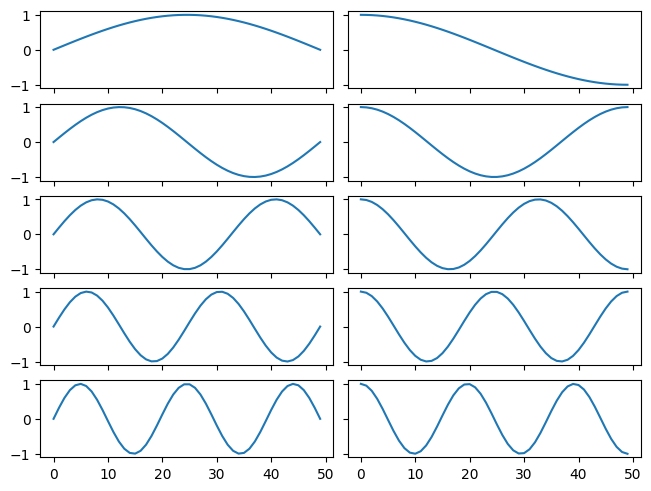

In [20]:
import matplotlib.pyplot as plt

fig,axes = plt.subplots(len(freqs),2,
                        layout='constrained',
                        sharex=True,
                        sharey=True)

for ax_row, sine_function, cosine_function in zip(axes,sines,cosines):
    ax_row[0].plot(sine_function)
    ax_row[1].plot(cosine_function)

We have created both sine and cosine functions because we will be looking at both real and complex modes.  Let's now create the ``shape_matrix`` field.  We see that our functions are already the correct shapes, as they have shape ``(5,50)`` or ``(num_shape, num_coord)``.

In [21]:
sines.shape

(5, 50)

In [22]:
cosines.shape

(5, 50)

In [23]:
shape_coords = sdpy.coordinate_array(np.arange(50)+1, 'Z+')
shape_coords

coordinate_array(string_array=
array(['1Z+', '2Z+', '3Z+', '4Z+', '5Z+', '6Z+', '7Z+', '8Z+', '9Z+',
       '10Z+', '11Z+', '12Z+', '13Z+', '14Z+', '15Z+', '16Z+', '17Z+',
       '18Z+', '19Z+', '20Z+', '21Z+', '22Z+', '23Z+', '24Z+', '25Z+',
       '26Z+', '27Z+', '28Z+', '29Z+', '30Z+', '31Z+', '32Z+', '33Z+',
       '34Z+', '35Z+', '36Z+', '37Z+', '38Z+', '39Z+', '40Z+', '41Z+',
       '42Z+', '43Z+', '44Z+', '45Z+', '46Z+', '47Z+', '48Z+', '49Z+',
       '50Z+'], dtype='<U4'))

In [24]:
real_shapes = sdpy.shape_array(
    coordinate = shape_coords,
    shape_matrix = sines,
    frequency = freqs)

complex_shapes = sdpy.shape_array(
    coordinate = shape_coords,
    shape_matrix = sines+1j*cosines,
    frequency = freqs)

In [25]:
real_shapes = sdpy.shape_array(
    coordinate = shape_coords,
    shape_matrix = sines,
    frequency = freqs,
    damping = 0,
    modal_mass = 1)

complex_shapes = sdpy.shape_array(
    coordinate = shape_coords,
    shape_matrix = sines+1j*cosines,
    frequency = freqs,
    damping = 0,
    modal_mass = 1)

In [26]:
real_shapes = sdpy.shape_array(
    coordinate = shape_coords[:-1], # Pull off the last coordinate so it's the wrong shape
    shape_matrix = sines,
    frequency = freqs,
    damping = 0,
    modal_mass = 1)

ValueError: could not broadcast input array from shape (49,) into shape (5,50)

## Comparing Real and Complex Shapes

In [27]:
real_shapes.dtype

dtype([('frequency', '<f8'), ('damping', '<f8'), ('coordinate', [('node', '<u8'), ('direction', 'i1')], (50,)), ('shape_matrix', '<f8', (50,)), ('modal_mass', '<f8'), ('comment1', '<U80'), ('comment2', '<U80'), ('comment3', '<U80'), ('comment4', '<U80'), ('comment5', '<U80')])

In [28]:
complex_shapes.dtype

dtype([('frequency', '<f8'), ('damping', '<f8'), ('coordinate', [('node', '<u8'), ('direction', 'i1')], (50,)), ('shape_matrix', '<c16', (50,)), ('modal_mass', '<c16'), ('comment1', '<U80'), ('comment2', '<U80'), ('comment3', '<U80'), ('comment4', '<U80'), ('comment5', '<U80')])

In [29]:
real_shapes.is_complex()

False

In [30]:
complex_shapes.is_complex()

True

In [31]:
real_shapes_converted = real_shapes.to_complex()
real_shapes_converted.dtype

dtype([('frequency', '<f8'), ('damping', '<f8'), ('coordinate', [('node', '<u8'), ('direction', 'i1')], (50,)), ('shape_matrix', '<c16', (50,)), ('modal_mass', '<c16'), ('comment1', '<U80'), ('comment2', '<U80'), ('comment3', '<U80'), ('comment4', '<U80'), ('comment5', '<U80')])

We can see above if we convert the ``real_shapes`` to a complex shape, the ``shape_matrix`` is now a complex field rather than a real field.

Similarly with the complex shapes:

In [32]:
complex_shapes_converted = complex_shapes.to_real()
complex_shapes_converted.dtype

dtype([('frequency', '<f8'), ('damping', '<f8'), ('coordinate', [('node', '<u8'), ('direction', 'i1')], (50,)), ('shape_matrix', '<f8', (50,)), ('modal_mass', '<f8'), ('comment1', '<U80'), ('comment2', '<U80'), ('comment3', '<U80'), ('comment4', '<U80'), ('comment5', '<U80')])

In [33]:
# Check if the shape matrix of the converted-to-real shapes is the same as the
# real part of the complex shape matrix
complex_shapes_converted.shape_matrix == complex_shapes.shape_matrix.real

array([[False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False],
       [False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False],
       [False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, Fal

## Plotting Shapes on Geometry

In [34]:
nodes = sdpy.node_array(
    id = np.arange(50)+1, # node ids, 1-50
    coordinate = np.array((
        np.linspace(0,1,50,endpoint=True), # X-coord goes from 0 to 1
        np.zeros(50), # Y-coord is zero
        np.zeros(50)) # Z-coord is zero
          ).T, # Transpose to make it 50x3 vs 3x50
    color = 1, # Blue
    disp_cs = 1, # Will only have CS #1, global cs
    def_cs = 1)

cs = sdpy.coordinate_system_array(1) # Default is cartesian with no transform

traceline = sdpy.traceline_array(
    id=1,
    color=1, # Blue
    connectivity=np.arange(50)+1) # Connect all nodes

beam_geometry = sdpy.Geometry(nodes,cs,traceline)

Of course, we should always plot our geometry to make sure it looks like we expect it to.

In [35]:
beam_geometry.plot(label_nodes=True)

(<sdynpy.core.sdynpy_geometry.GeometryPlotter at 0x1487f2d68d0>,
 PolyData (0x1487f2e3ca0)
   N Cells:    1
   N Points:   50
   N Strips:   0
   X Bounds:   0.000e+00, 1.000e+00
   Y Bounds:   0.000e+00, 0.000e+00
   Z Bounds:   0.000e+00, 0.000e+00
   N Arrays:   1,
 PolyData (0x1487f2e3b20)
   N Cells:    50
   N Points:   50
   N Strips:   0
   X Bounds:   0.000e+00, 1.000e+00
   Y Bounds:   0.000e+00, 0.000e+00
   Z Bounds:   0.000e+00, 0.000e+00
   N Arrays:   2,
 None)

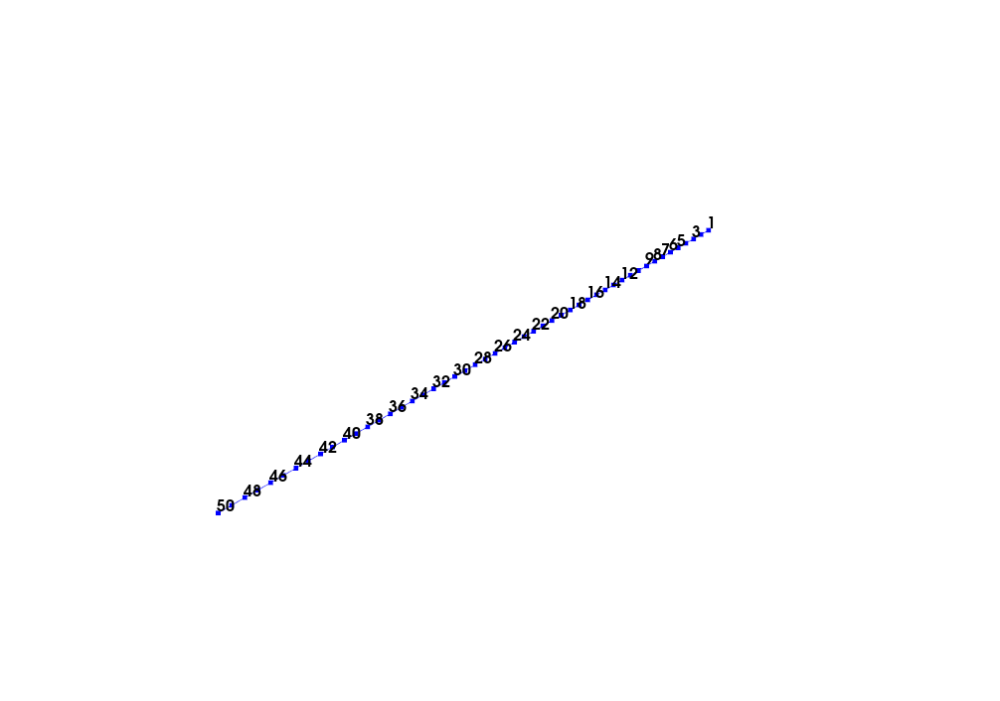

In [36]:
beam_geometry.plot_shape(real_shapes)

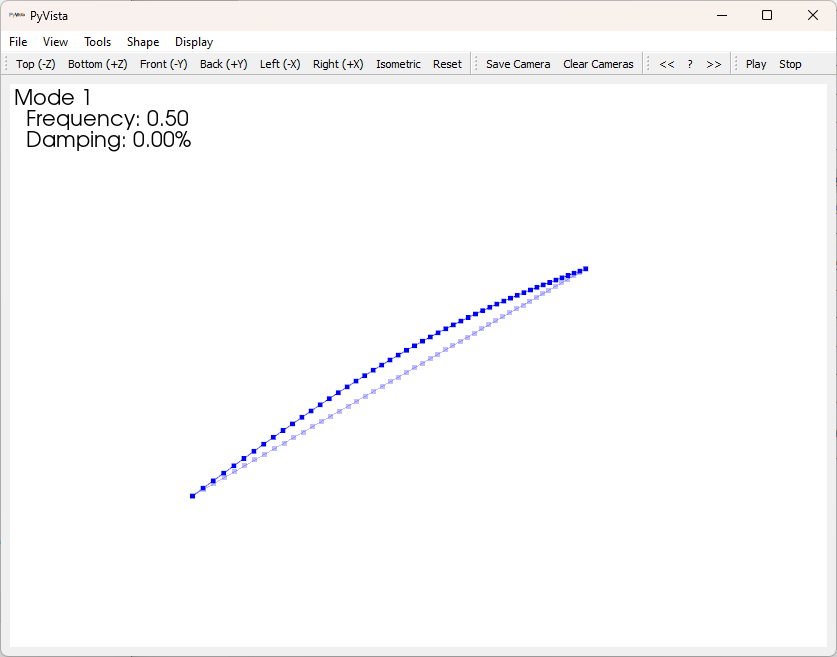



 - ``<<`` Change to the previous mode
 - ``?`` Bring up a table so a specific mode can be selected
 - ``>>`` Change to the next mode
 - ``Play`` Animates the mode
 - ``Stop`` Stops the mode animation

We can do the same with the complex shapes.

In [37]:
beam_geometry.plot_shape(complex_shapes)

When we plot the two shapes side-by-side, we can see some differences between real and complex shapes.  The real shapes appear as a "standing wave".  Zero points in the shape do not move.  All points hit their maximum values at the same time.

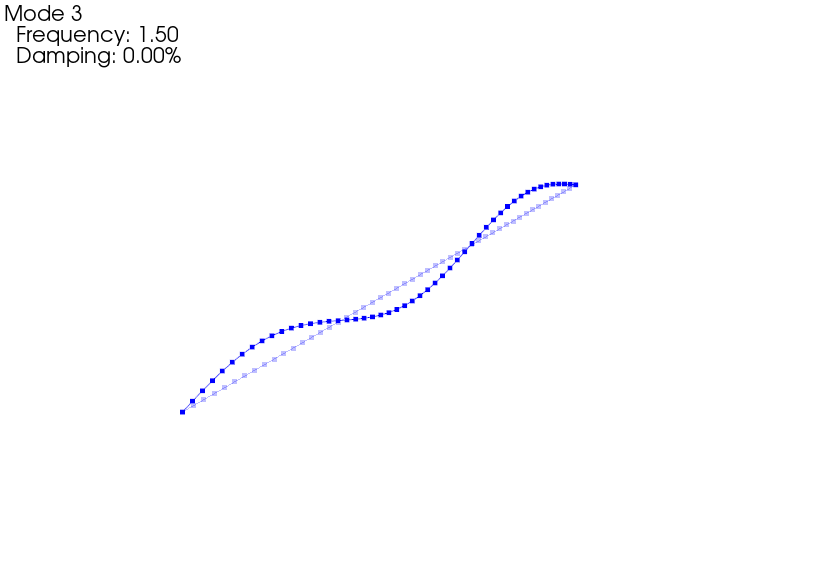

Contrast this to the complex shapes; they appear as a "traveling wave" with the zero points as well as the points hitting their maximum values moving along the geometry.

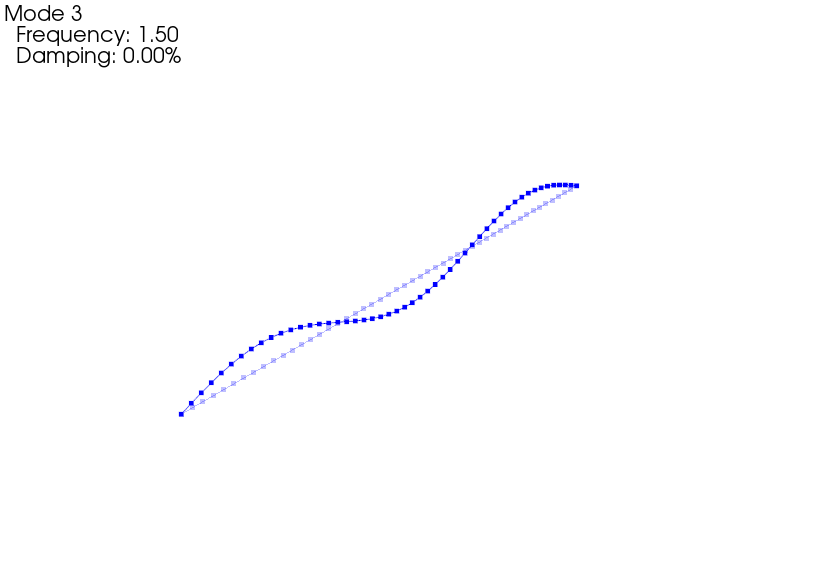

## Indexing Shapes to Extract Coefficients

In [38]:
real_shapes.coordinate.shape

(5, 50)

In [39]:
real_shapes.shape_matrix.shape

(5, 50)

It should then be obvious how one might map the coefficients in the shape matrix to coordinates.  A coordinate at a specific index corresponds to the shape coefficient at that same index.

In [40]:
index = (0,3)
print('At index {:} the shape coefficient {:} corresponds to coordinate {:}'.format(
    index,real_shapes.shape_matrix[index],str(real_shapes.coordinate[index])))

At index (0, 3) the shape coefficient 0.1911586287013723 corresponds to coordinate 4Z+


In [41]:
coords = sdpy.coordinate_array([4,15],'Z+')
coords

coordinate_array(string_array=
array(['4Z+', '15Z+'], dtype='<U4'))

In [42]:
real_shapes[coords]

array([[ 0.19115863,  0.78183148],
       [ 0.375267  ,  0.97492791],
       [ 0.5455349 ,  0.43388374],
       [ 0.69568255, -0.43388374],
       [ 0.82017225, -0.97492791]])

In [43]:
real_shapes.coordinate

coordinate_array(string_array=
array([['1Z+', '2Z+', '3Z+', '4Z+', '5Z+', '6Z+', '7Z+', '8Z+', '9Z+',
        '10Z+', '11Z+', '12Z+', '13Z+', '14Z+', '15Z+', '16Z+', '17Z+',
        '18Z+', '19Z+', '20Z+', '21Z+', '22Z+', '23Z+', '24Z+', '25Z+',
        '26Z+', '27Z+', '28Z+', '29Z+', '30Z+', '31Z+', '32Z+', '33Z+',
        '34Z+', '35Z+', '36Z+', '37Z+', '38Z+', '39Z+', '40Z+', '41Z+',
        '42Z+', '43Z+', '44Z+', '45Z+', '46Z+', '47Z+', '48Z+', '49Z+',
        '50Z+'],
       ['1Z+', '2Z+', '3Z+', '4Z+', '5Z+', '6Z+', '7Z+', '8Z+', '9Z+',
        '10Z+', '11Z+', '12Z+', '13Z+', '14Z+', '15Z+', '16Z+', '17Z+',
        '18Z+', '19Z+', '20Z+', '21Z+', '22Z+', '23Z+', '24Z+', '25Z+',
        '26Z+', '27Z+', '28Z+', '29Z+', '30Z+', '31Z+', '32Z+', '33Z+',
        '34Z+', '35Z+', '36Z+', '37Z+', '38Z+', '39Z+', '40Z+', '41Z+',
        '42Z+', '43Z+', '44Z+', '45Z+', '46Z+', '47Z+', '48Z+', '49Z+',
        '50Z+'],
       ['1Z+', '2Z+', '3Z+', '4Z+', '5Z+', '6Z+', '7Z+', '8Z+', '9Z+',
  

However, if we request coordinates with negative polarities, it will simply flip the coefficients corresponding to those degrees of freedom.  Let's show the previous case again, but now flip the sign on one of the coordinates:

In [44]:
coords_positive = sdpy.coordinate_array([4,15],'Z+')
coords_positive

coordinate_array(string_array=
array(['4Z+', '15Z+'], dtype='<U4'))

In [45]:
coords_w_negative = sdpy.coordinate_array([4,15],['Z+','Z-'])
coords_w_negative

coordinate_array(string_array=
array(['4Z+', '15Z-'], dtype='<U4'))

In [46]:
real_shapes[coords_positive]

array([[ 0.19115863,  0.78183148],
       [ 0.375267  ,  0.97492791],
       [ 0.5455349 ,  0.43388374],
       [ 0.69568255, -0.43388374],
       [ 0.82017225, -0.97492791]])

In [47]:
real_shapes[coords_w_negative]

array([[ 0.19115863, -0.78183148],
       [ 0.375267  , -0.97492791],
       [ 0.5455349 , -0.43388374],
       [ 0.69568255,  0.43388374],
       [ 0.82017225,  0.97492791]])

In [48]:
coords_2d = sdpy.coordinate_array([[1,2,3],[4,5,6]], 'Z+')
coords_2d

coordinate_array(string_array=
array([['1Z+', '2Z+', '3Z+'],
       ['4Z+', '5Z+', '6Z+']], dtype='<U3'))

In [49]:
real_shapes[coords_2d]

array([[[0.        , 0.06407022, 0.12787716],
        [0.19115863, 0.25365458, 0.31510822]],

       [[0.        , 0.12787716, 0.25365458],
        [0.375267  , 0.49071755, 0.59811053]],

       [[0.        , 0.19115863, 0.375267  ],
        [0.5455349 , 0.69568255, 0.82017225]],

       [[0.        , 0.25365458, 0.49071755],
        [0.69568255, 0.85514276, 0.95866785]],

       [[0.        , 0.31510822, 0.59811053],
        [0.82017225, 0.95866785, 0.99948622]]])

In [50]:
real_shapes[coords_2d].shape

(5, 2, 3)

## Creating Rigid Body Shapes

In [51]:
geometry = sdpy.geometry.load('geometry.npz')
geometry.plot(label_nodes=True,show_edges=True,opacity=0.75)

(<sdynpy.core.sdynpy_geometry.GeometryPlotter at 0x1487f32e060>,
 PolyData (0x14896dfd240)
   N Cells:    33
   N Points:   51
   N Strips:   0
   X Bounds:   -1.000e+00, 1.000e+00
   Y Bounds:   -1.000e+00, 1.000e+00
   Z Bounds:   -3.000e+00, 3.000e+00
   N Arrays:   1,
 PolyData (0x1487f31be80)
   N Cells:    51
   N Points:   51
   N Strips:   0
   X Bounds:   -1.000e+00, 1.000e+00
   Y Bounds:   -1.000e+00, 1.000e+00
   Z Bounds:   -3.000e+00, 3.000e+00
   N Arrays:   2,
 None)

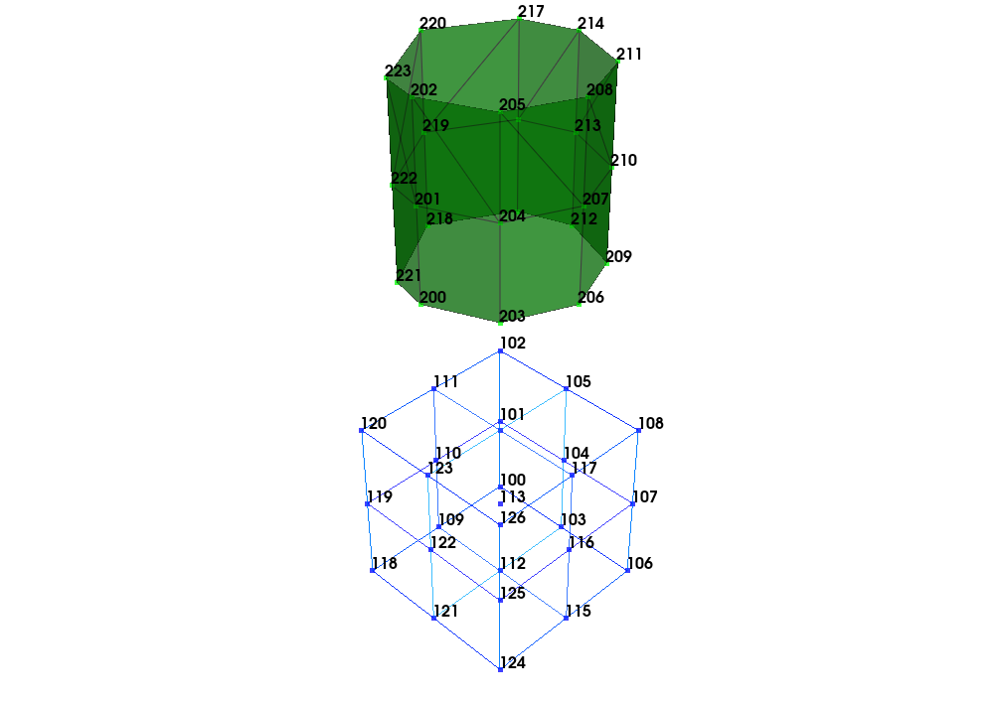

In [52]:
geometry_coordinates = sdpy.coordinate_array(geometry.node.id,['X+','Y+','Z+'],force_broadcast=True)
rigid_shapes = geometry.rigid_body_shapes(geometry_coordinates)

In [53]:
geometry.plot_shape(rigid_shapes)

| Translations | Rotations |
|--------------|-----------|
| 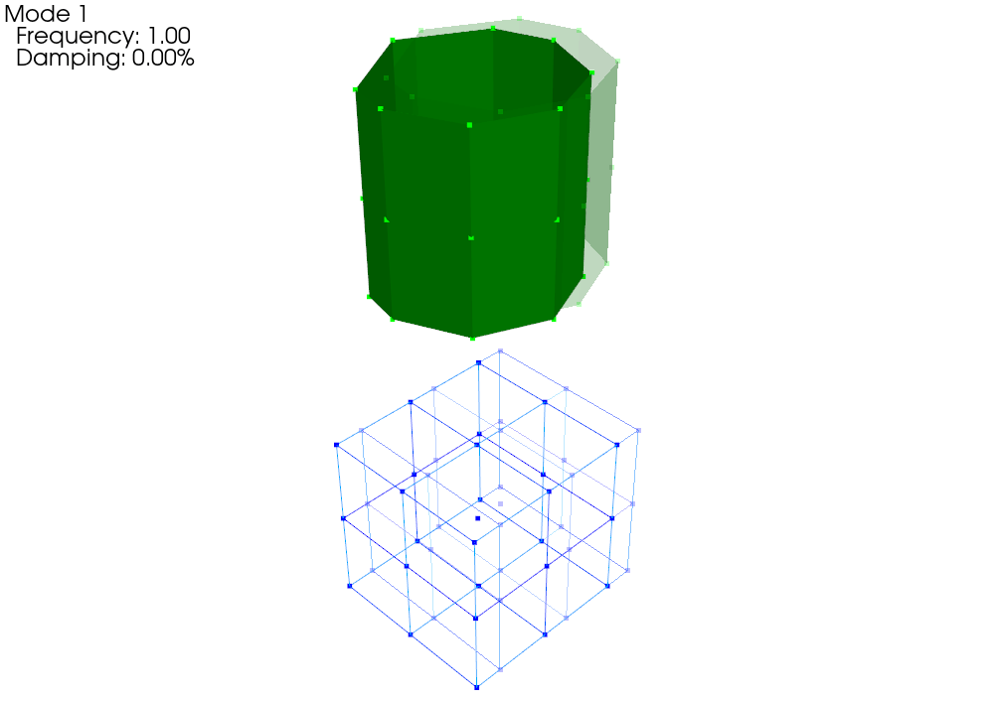 | 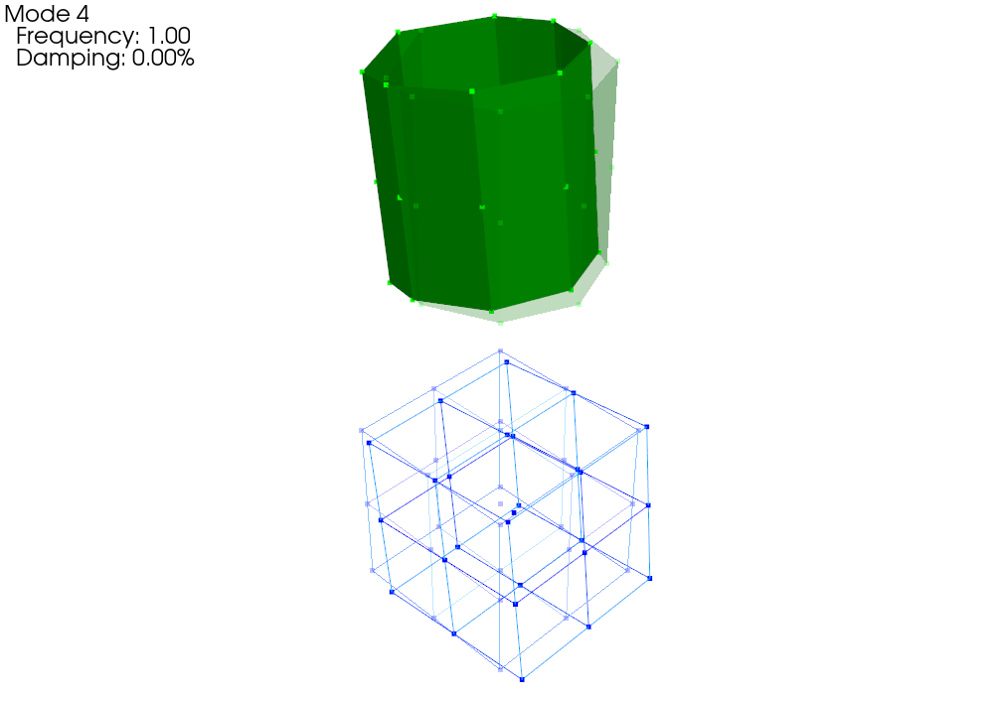 |
| 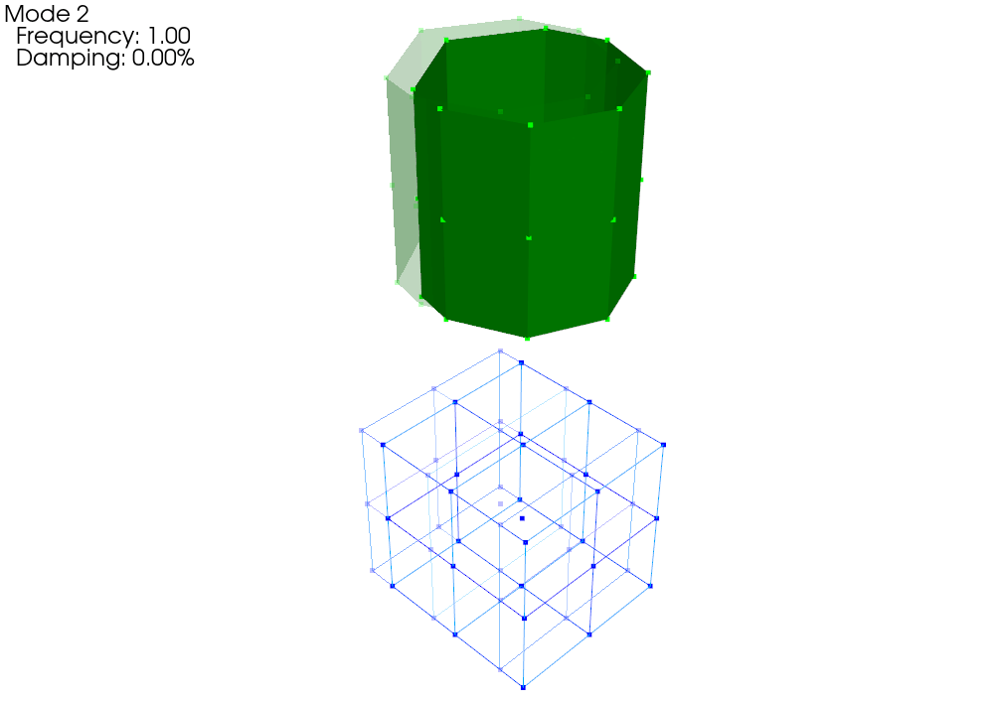 | 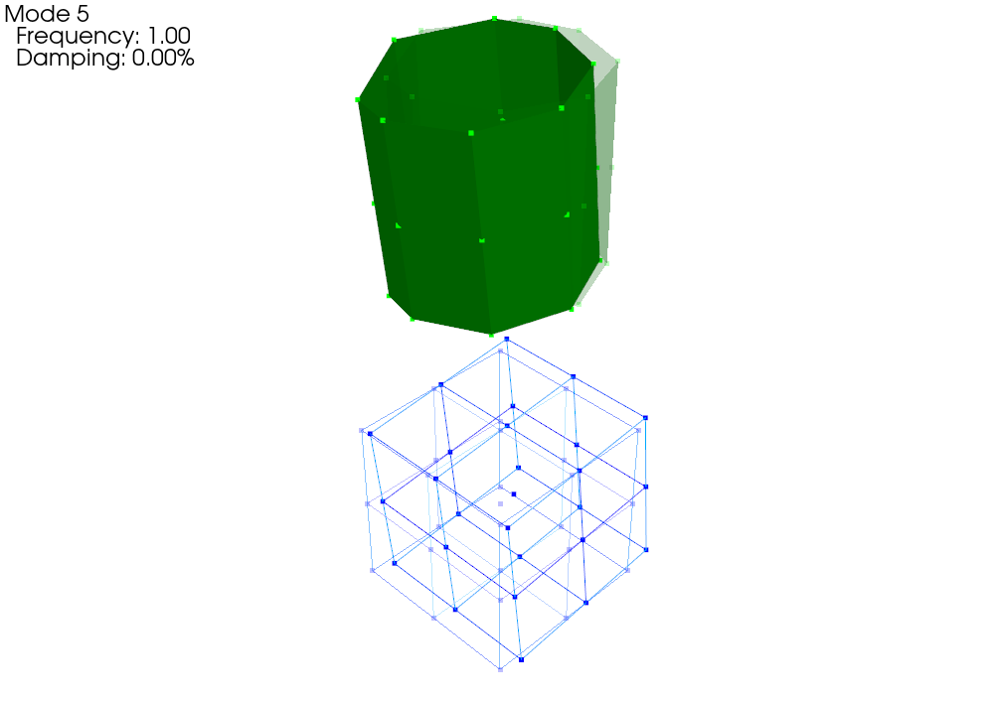 |
| 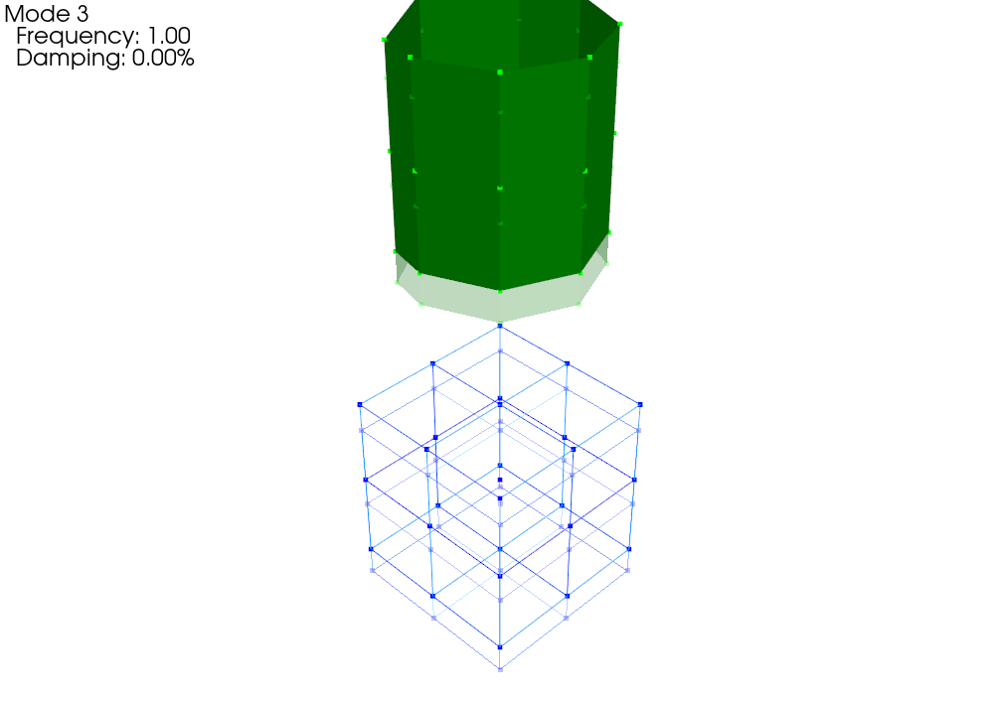 | 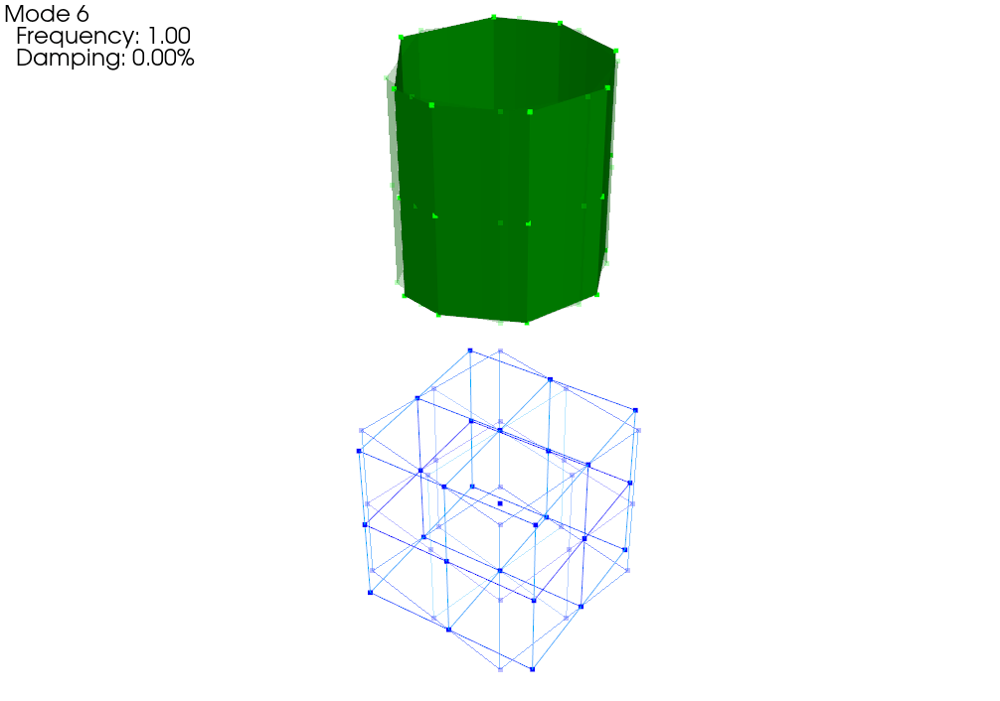 |

## Reducing Shapes

In [54]:
# Reduce the cube by node
cube_nodes = geometry.node.id[geometry.node.id < 200]
cube_shapes = rigid_shapes.reduce(cube_nodes)
# Reduce the cylinder by degrees of freedom
# We take the unique coordinates because each shape
# has all of the coordinates
cylinder_coords = np.unique(
    rigid_shapes.coordinate[rigid_shapes.coordinate.node >= 200])
cylinder_shapes = rigid_shapes.reduce(cylinder_coords)

In [55]:
geometry.plot_shape(cube_shapes)

Node 200 not found in shape array
Node 201 not found in shape array
Node 202 not found in shape array
Node 203 not found in shape array
Node 204 not found in shape array
Node 205 not found in shape array
Node 206 not found in shape array
Node 207 not found in shape array
Node 208 not found in shape array
Node 209 not found in shape array
Node 210 not found in shape array
Node 211 not found in shape array
Node 212 not found in shape array
Node 213 not found in shape array
Node 214 not found in shape array
Node 215 not found in shape array
Node 216 not found in shape array
Node 217 not found in shape array
Node 218 not found in shape array
Node 219 not found in shape array
Node 220 not found in shape array
Node 221 not found in shape array
Node 222 not found in shape array
Node 223 not found in shape array


In [56]:
geometry.plot_shape(cylinder_shapes)

Node 100 not found in shape array
Node 101 not found in shape array
Node 102 not found in shape array
Node 103 not found in shape array
Node 104 not found in shape array
Node 105 not found in shape array
Node 106 not found in shape array
Node 107 not found in shape array
Node 108 not found in shape array
Node 109 not found in shape array
Node 110 not found in shape array
Node 111 not found in shape array
Node 112 not found in shape array
Node 113 not found in shape array
Node 114 not found in shape array
Node 115 not found in shape array
Node 116 not found in shape array
Node 117 not found in shape array
Node 118 not found in shape array
Node 119 not found in shape array
Node 120 not found in shape array
Node 121 not found in shape array
Node 122 not found in shape array
Node 123 not found in shape array
Node 124 not found in shape array
Node 125 not found in shape array
Node 126 not found in shape array


| Cube Shapes | Cylinder Shapes |
|-------------|-----------------|
|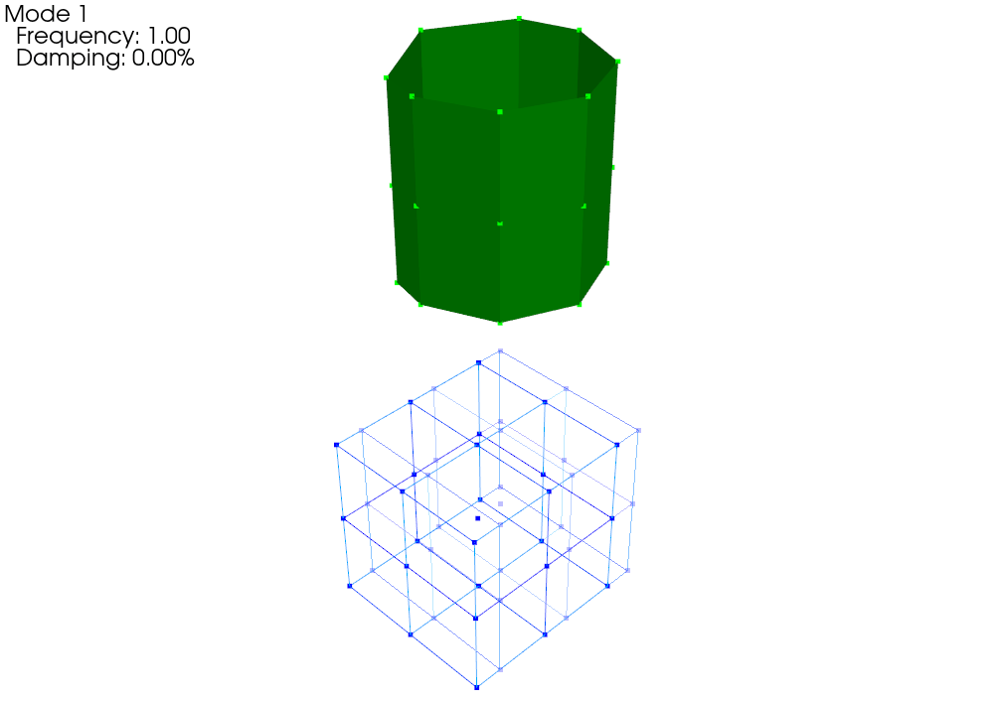 | 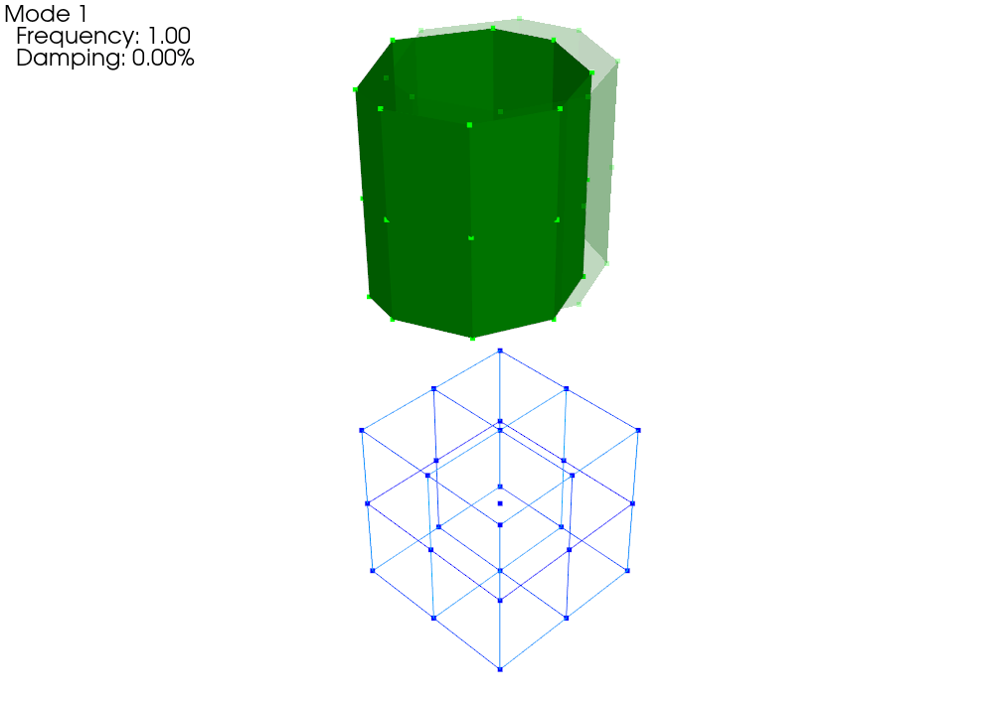 |

## Combining Shapes

In [57]:
# Call as a static class method
recombined_shapes = sdpy.ShapeArray.concatenate_dofs([cube_shapes,cylinder_shapes])
# Call as a module function
recombined_shapes = sdpy.shape.concatenate_dofs([cube_shapes,cylinder_shapes])
# Both call the same function and return the same output.

In [58]:
geometry.plot_shape(recombined_shapes)

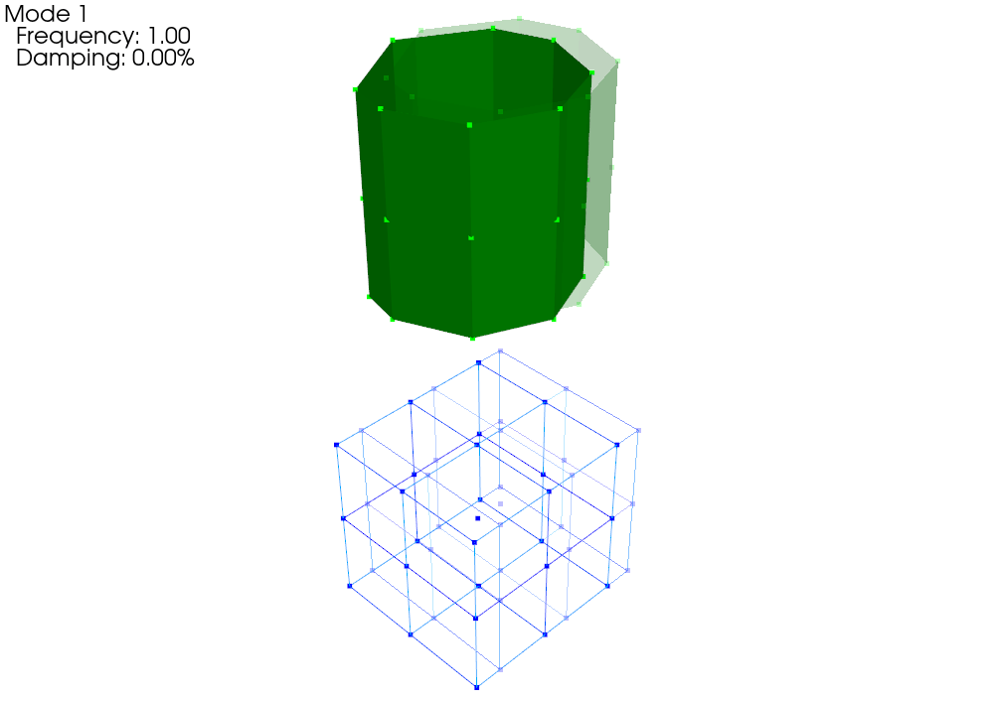

In [59]:
overlaid_geometry,overlaid_shapes = sdpy.ShapeArray.overlay_shapes(
    [geometry,geometry], # In this case, both sets of shapes use the same geometry
    [cube_shapes, cylinder_shapes],
    color_override = [1,7]) # Override the colors so the first geometry is blue and the second is green.

In [60]:
overlaid_geometry.node

   Index,     ID,        X,        Y,        Z, DefCS, DisCS
    (0,),   1100,   -1.000,   -1.000,   -3.000,    11,    11
    (1,),   1101,   -1.000,   -1.000,   -2.000,    11,    11
    (2,),   1102,   -1.000,   -1.000,   -1.000,    11,    11
    (3,),   1103,   -1.000,    0.000,   -3.000,    11,    11
    (4,),   1104,   -1.000,    0.000,   -2.000,    11,    11
    (5,),   1105,   -1.000,    0.000,   -1.000,    11,    11
    (6,),   1106,   -1.000,    1.000,   -3.000,    11,    11
    (7,),   1107,   -1.000,    1.000,   -2.000,    11,    11
    (8,),   1108,   -1.000,    1.000,   -1.000,    11,    11
    (9,),   1109,    0.000,   -1.000,   -3.000,    11,    11
   (10,),   1110,    0.000,   -1.000,   -2.000,    11,    11
   (11,),   1111,    0.000,   -1.000,   -1.000,    11,    11
   (12,),   1112,    0.000,    0.000,   -3.000,    11,    11
   (13,),   1113,    0.000,    0.000,   -2.000,    11,    11
   (14,),   1114,    0.000,    0.000,   -1.000,    11,    11
   (15,),   1115,    0.0

In [61]:
overlaid_shapes[0].coordinate

coordinate_array(string_array=
array(['1100X+', '1100Y+', '1100Z+', '1101X+', '1101Y+', '1101Z+',
       '1102X+', '1102Y+', '1102Z+', '1103X+', '1103Y+', '1103Z+',
       '1104X+', '1104Y+', '1104Z+', '1105X+', '1105Y+', '1105Z+',
       '1106X+', '1106Y+', '1106Z+', '1107X+', '1107Y+', '1107Z+',
       '1108X+', '1108Y+', '1108Z+', '1109X+', '1109Y+', '1109Z+',
       '1110X+', '1110Y+', '1110Z+', '1111X+', '1111Y+', '1111Z+',
       '1112X+', '1112Y+', '1112Z+', '1113X+', '1113Y+', '1113Z+',
       '1114X+', '1114Y+', '1114Z+', '1115X+', '1115Y+', '1115Z+',
       '1116X+', '1116Y+', '1116Z+', '1117X+', '1117Y+', '1117Z+',
       '1118X+', '1118Y+', '1118Z+', '1119X+', '1119Y+', '1119Z+',
       '1120X+', '1120Y+', '1120Z+', '1121X+', '1121Y+', '1121Z+',
       '1122X+', '1122Y+', '1122Z+', '1123X+', '1123Y+', '1123Z+',
       '1124X+', '1124Y+', '1124Z+', '1125X+', '1125Y+', '1125Z+',
       '1126X+', '1126Y+', '1126Z+', '2200X+', '2200Y+', '2200Z+',
       '2201X+', '2201Y+', '220

In [62]:
overlaid_geometry.plot_shape(overlaid_shapes)

Node 1200 not found in shape array
Node 1201 not found in shape array
Node 1202 not found in shape array
Node 1203 not found in shape array
Node 1204 not found in shape array
Node 1205 not found in shape array
Node 1206 not found in shape array
Node 1207 not found in shape array
Node 1208 not found in shape array
Node 1209 not found in shape array
Node 1210 not found in shape array
Node 1211 not found in shape array
Node 1212 not found in shape array
Node 1213 not found in shape array
Node 1214 not found in shape array
Node 1215 not found in shape array
Node 1216 not found in shape array
Node 1217 not found in shape array
Node 1218 not found in shape array
Node 1219 not found in shape array
Node 1220 not found in shape array
Node 1221 not found in shape array
Node 1222 not found in shape array
Node 1223 not found in shape array
Node 2100 not found in shape array
Node 2101 not found in shape array
Node 2102 not found in shape array
Node 2103 not found in shape array
Node 2104 not found 

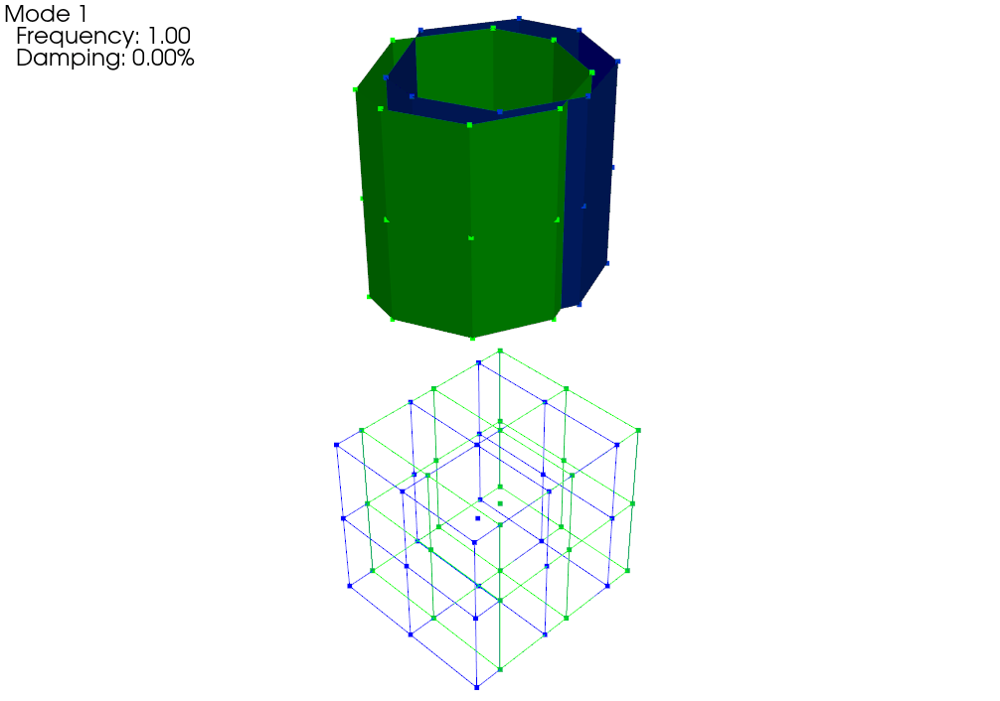

## Reading and Writing Universal Files

In [63]:
rigid_shapes.write_to_unv('shapes.unv')

This will write a file containing the following text (with each dataset truncated for brevity).

````
    -1
    55
NONE                                                                            
NONE                                                                            
NONE                                                                            
NONE                                                                            
NONE                                                                            
         1         2         2        12         2         3                    
         2         4         0         1                                        
  1.00000E+00  1.00000E+00  0.00000E+00  0.00000E+00                            
       100                                                                      
  1.00000E+00  0.00000E+00  0.00000E+00                                         
       101                                                                      
  1.00000E+00  0.00000E+00  0.00000E+00                                         
       102                                                                      
  1.00000E+00  0.00000E+00  0.00000E+00                                         
       103                                                                      
  1.00000E+00  0.00000E+00  0.00000E+00                                         
````
. . .
````
       222                                                                      
  9.06308E-01  4.22618E-01  0.00000E+00                                         
       223                                                                      
  9.06308E-01  4.22618E-01  0.00000E+00                                         
    -1
    -1
    55
NONE                                                                            
NONE                                                                            
NONE                                                                            
NONE                                                                            
NONE                                                                            
         1         2         2        12         2         3                    
         2         4         0         2                                        
  1.00000E+00  1.00000E+00  0.00000E+00  0.00000E+00                            
       100                                                                      
  0.00000E+00  1.00000E+00  0.00000E+00                                         
       101                                                                      
  0.00000E+00  1.00000E+00  0.00000E+00                                         
       102                                                                      
  0.00000E+00  1.00000E+00  0.00000E+00                                         
       103                                                                      
  0.00000E+00  1.00000E+00  0.00000E+00                                         
````
. . .
````
       222                                                                      
 -4.22618E-01  9.06308E-01  0.00000E+00                                         
       223                                                                      
 -4.22618E-01  9.06308E-01  0.00000E+00                                         
    -1
    -1
    55
NONE                                                                            
NONE                                                                            
NONE                                                                            
NONE                                                                            
NONE                                                                            
         1         2         2        12         2         3                    
         2         4         0         3                                        
  1.00000E+00  1.00000E+00  0.00000E+00  0.00000E+00                            
       100                                                                      
  0.00000E+00  0.00000E+00  1.00000E+00                                         
       101                                                                      
  0.00000E+00  0.00000E+00  1.00000E+00                                         
       102                                                                      
  0.00000E+00  0.00000E+00  1.00000E+00                                         
       103                                                                      
  0.00000E+00  0.00000E+00  1.00000E+00                                         
````
. . .
````
       222                                                                      
  0.00000E+00  0.00000E+00  1.00000E+00                                         
       223                                                                      
  0.00000E+00  0.00000E+00  1.00000E+00                                         
    -1
    -1
    55
NONE                                                                            
NONE                                                                            
NONE                                                                            
NONE                                                                            
NONE                                                                            
         1         2         2        12         2         3                    
         2         4         0         4                                        
  1.00000E+00  1.00000E+00  0.00000E+00  0.00000E+00                            
       100                                                                      
  0.00000E+00  3.00000E+00 -1.00000E+00                                         
       101                                                                      
  0.00000E+00  2.00000E+00 -1.00000E+00                                         
       102                                                                      
  0.00000E+00  1.00000E+00 -1.00000E+00                                         
       103                                                                      
  0.00000E+00  3.00000E+00  0.00000E+00                                         
````
. . .
````
       222                                                                      
  8.45237E-01 -1.81262E+00 -4.22618E-01                                         
       223                                                                      
  1.26785E+00 -2.71892E+00 -4.22618E-01                                         
    -1
    -1
    55
NONE                                                                            
NONE                                                                            
NONE                                                                            
NONE                                                                            
NONE                                                                            
         1         2         2        12         2         3                    
         2         4         0         5                                        
  1.00000E+00  1.00000E+00  0.00000E+00  0.00000E+00                            
       100                                                                      
 -3.00000E+00  0.00000E+00  1.00000E+00                                         
       101                                                                      
 -2.00000E+00  0.00000E+00  1.00000E+00                                         
       102                                                                      
 -1.00000E+00  0.00000E+00  1.00000E+00                                         
       103                                                                      
 -3.00000E+00  0.00000E+00  1.00000E+00                                         
````
. . .
````
       222                                                                      
  1.81262E+00  8.45237E-01 -9.06308E-01                                         
       223                                                                      
  2.71892E+00  1.26785E+00 -9.06308E-01                                         
    -1
    -1
    55
NONE                                                                            
NONE                                                                            
NONE                                                                            
NONE                                                                            
NONE                                                                            
         1         2         2        12         2         3                    
         2         4         0         6                                        
  1.00000E+00  1.00000E+00  0.00000E+00  0.00000E+00                            
       100                                                                      
  1.00000E+00 -1.00000E+00  0.00000E+00                                         
       101                                                                      
  1.00000E+00 -1.00000E+00  0.00000E+00                                         
       102                                                                      
  1.00000E+00 -1.00000E+00  0.00000E+00                                         
       103                                                                      
  0.00000E+00 -1.00000E+00  0.00000E+00                                         
````
. . .
````
       222                                                                      
 -5.55112E-17  1.00000E+00  0.00000E+00                                         
       223                                                                      
 -5.55112E-17  1.00000E+00  0.00000E+00                                         
    -1

````

In [64]:
# Using the static method
shapes_from_unv = sdpy.ShapeArray.load('shapes.unv')
# Identical to using the aliased module function
shapes_from_unv = sdpy.shape.load('shapes.unv')

In [65]:
unv_dict = sdpy.unv.readunv('shapes.unv')
unv_dict

{55: [Sdynpy_UFF_Dataset_55<Shape with 51 Nodes>,
  Sdynpy_UFF_Dataset_55<Shape with 51 Nodes>,
  Sdynpy_UFF_Dataset_55<Shape with 51 Nodes>,
  Sdynpy_UFF_Dataset_55<Shape with 51 Nodes>,
  Sdynpy_UFF_Dataset_55<Shape with 51 Nodes>,
  Sdynpy_UFF_Dataset_55<Shape with 51 Nodes>]}

In [66]:
# Using the static method
shapes_from_unv = sdpy.ShapeArray.from_unv(unv_dict)
# Or using the module alias
shapes_from_unv = sdpy.shape.from_unv(unv_dict)

## Reading and Writing to NumPy Files

In [67]:
rigid_shapes.save('shapes.npy')

In [68]:
# Static method
rigid_shapes_from_npy = sdpy.ShapeArray.load('shapes.npy')
# Equivalent Module-level Alias
rigid_shapes_from_npy = sdpy.shape.load('shapes.npy')

## Reading and Writing to Exodus Files

[Exodus](https://sandialabs.github.io/seacas-docs/exodusII-new.pdf) is a file format used at Sandia National Laboratories and elsewhere for finite element analysis mesh definition and results storage.  Because modal test and other structural dynamics datasets are often used to calibrate or validate models, it can be useful to bring the Exodus data and test data into SDynPy for comparison, or otherwise export the SDynPy data to an Exodus file for comparison using some other toolset.

In [69]:
exo_in_memory = sdpy.ExodusInMemory.from_sdynpy(geometry,rigid_shapes)

In [70]:
exo_in_memory.write_to_file('shapes.exo',clobber=True)

One the data is stored to an exodus file, it can be read in any number of Exodus readers.  For example, the open-source software [Paraview](https://www.paraview.org/) can read exodus files.  Here we have loaded in the ``geometry.exo`` file from the previous documentation to serve as an "undeformed" model and loaded in the ``shapes.exo`` file as the deformed model.

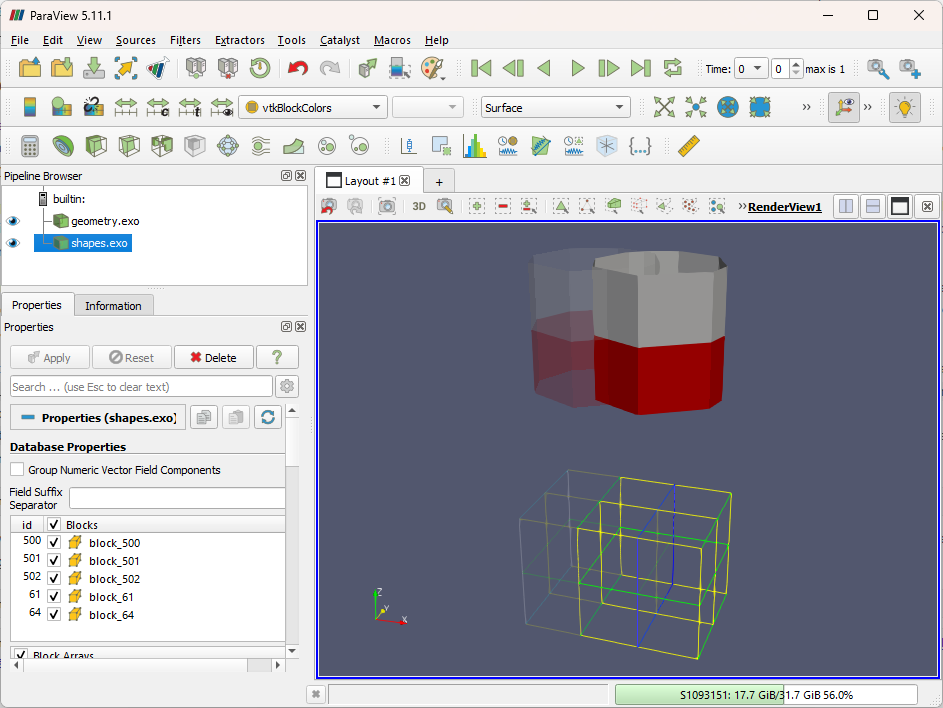

In [71]:
exo = sdpy.Exodus('shapes.exo')
exo

Exodus File at shapes.exo
  6 Timesteps
  51 Nodes
  96 Elements
  Blocks: 61, 64, 500, 501, 502
  Node Variables: DispX, DispY, DispZ, NodeColor
  Element Variables: ElemColor

We see that this Exodus file indeed has node variables ``DispX``, ``DispY``, and ``DispZ``.

In [72]:
geometry_from_exodus = sdpy.Geometry.from_exodus(exo)
shapes_from_exodus = sdpy.ShapeArray.from_exodus(exo)

In [73]:
geometry_from_exodus.plot_shape(shapes_from_exodus)

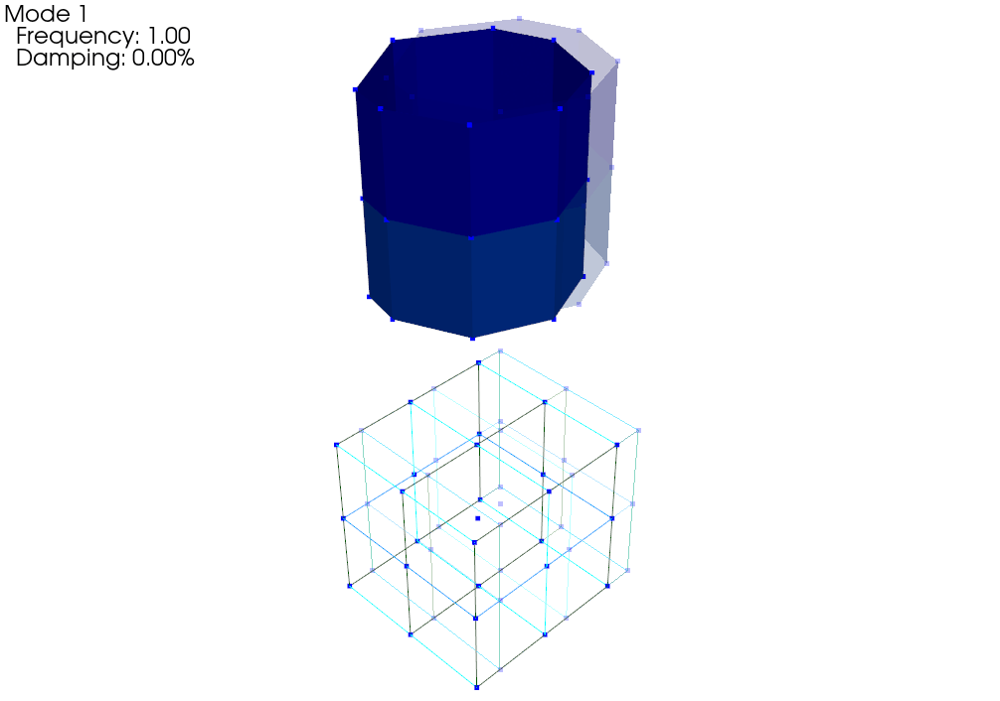

In [74]:
geometry.plot_shape(shapes_from_exodus)

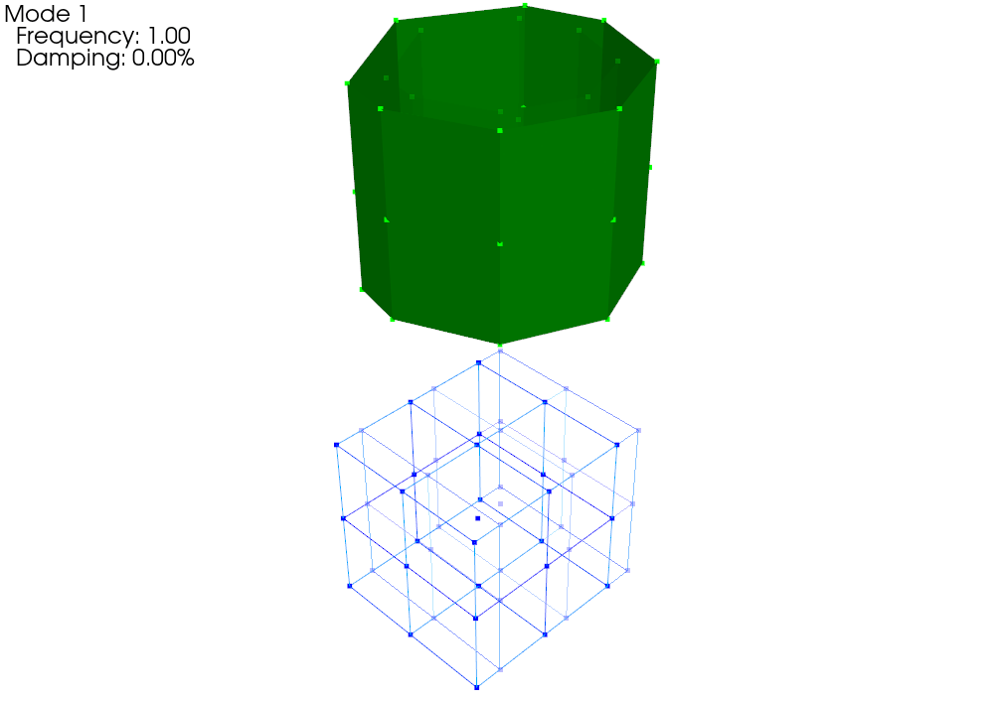

## Saving Shape Images and Animations

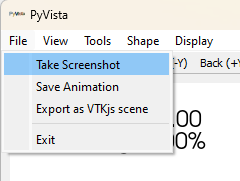

Alternatively, an animated ``.gif`` can be saved by clicking on the ``Save Animation`` option.

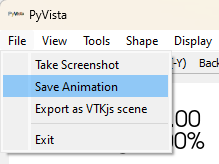

In [75]:
plotter = geometry.plot_shape(rigid_shapes)

In [76]:
plotter.screenshot('shape_figure.png');

In [77]:
plotter.save_animation('shape_animation.gif')

In [78]:
# The format string {:} will be replaced with the shape number
plotter.save_animation_all_shapes('shape_animation_{:}.gif')


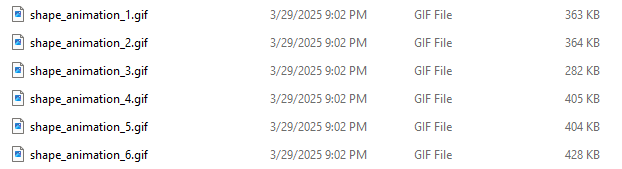

## Transforming Shape Coordinate Systems

In [79]:
geometry_global = geometry.copy()
geometry_global.node.disp_cs = 1 # 1 is the cartesian coordinate system, 2 is the cylindrical.

In [80]:
geometry_global.plot_coordinate(arrow_scale=0.05)

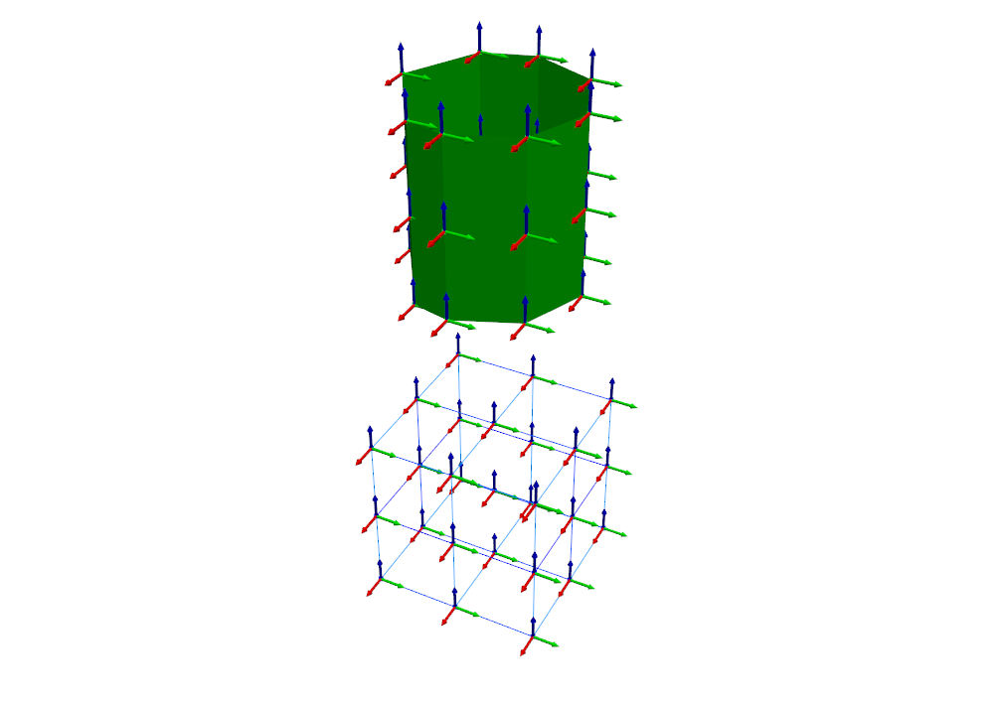

In [81]:
rigid_shapes_global = rigid_shapes.transform_coordinate_system(geometry, geometry_global)

In [82]:
geometry_global.plot_shape(rigid_shapes_global)

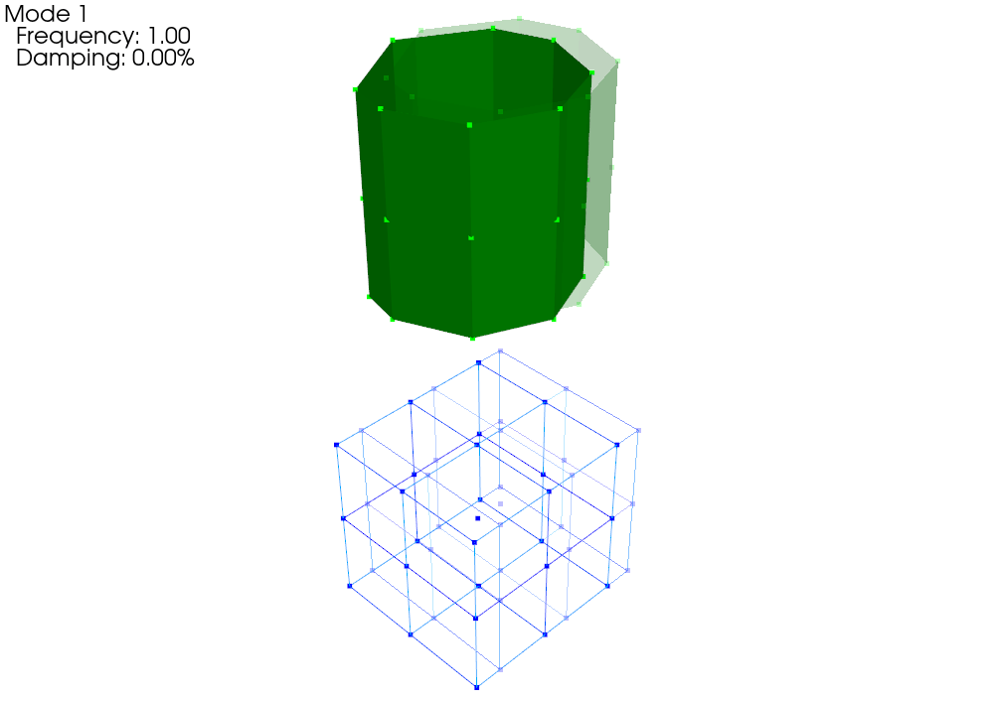

Indeed, we can look at shape coefficients for each of the shapes.  For example, the first shape is a translation in X+.  Therefore, we should see that if we look at the shape coefficients for that direction on the global shapes, they should all be identically 1.

In [84]:
x_coordinates = np.unique(rigid_shapes_global.coordinate[rigid_shapes_global.coordinate.direction == 1])
x_coordinates

coordinate_array(string_array=
array(['100X+', '101X+', '102X+', '103X+', '104X+', '105X+', '106X+',
       '107X+', '108X+', '109X+', '110X+', '111X+', '112X+', '113X+',
       '114X+', '115X+', '116X+', '117X+', '118X+', '119X+', '120X+',
       '121X+', '122X+', '123X+', '124X+', '125X+', '126X+', '200X+',
       '201X+', '202X+', '203X+', '204X+', '205X+', '206X+', '207X+',
       '208X+', '209X+', '210X+', '211X+', '212X+', '213X+', '214X+',
       '215X+', '216X+', '217X+', '218X+', '219X+', '220X+', '221X+',
       '222X+', '223X+'], dtype='<U5'))

In [87]:
# Index with an integer into the first shape,
# then with a CoordinateArray to get the shape
# coefficients
rigid_shapes_global[0][x_coordinates]

array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.])

We see that all of the coefficients in the X direction are identical.  Contrast with the non-global shapes, we will see that different X directions have different shape coefficients based on their projections into the global X direction.

In [86]:
rigid_shapes[0][x_coordinates]

array([ 1.00000000e+00,  1.00000000e+00,  1.00000000e+00,  1.00000000e+00,
        1.00000000e+00,  1.00000000e+00,  1.00000000e+00,  1.00000000e+00,
        1.00000000e+00,  1.00000000e+00,  1.00000000e+00,  1.00000000e+00,
        1.00000000e+00,  1.00000000e+00,  1.00000000e+00,  1.00000000e+00,
        1.00000000e+00,  1.00000000e+00,  1.00000000e+00,  1.00000000e+00,
        1.00000000e+00,  1.00000000e+00,  1.00000000e+00,  1.00000000e+00,
        1.00000000e+00,  1.00000000e+00,  1.00000000e+00,  1.00000000e+00,
        1.00000000e+00,  1.00000000e+00,  7.07106781e-01,  7.07106781e-01,
        7.07106781e-01,  6.12323400e-17,  6.12323400e-17,  6.12323400e-17,
       -7.07106781e-01, -7.07106781e-01, -7.07106781e-01, -1.00000000e+00,
       -1.00000000e+00, -1.00000000e+00, -8.19152044e-01, -8.19152044e-01,
       -8.19152044e-01, -1.60812265e-16, -1.60812265e-16, -1.60812265e-16,
        9.06307787e-01,  9.06307787e-01,  9.06307787e-01])

## Optimal Degree of Freedom Selection

In [92]:
optimized_shapes = real_shapes.optimize_degrees_of_freedom(
    sensors_to_keep = 5)

In [93]:
optimal_dofs = np.unique(optimized_shapes.coordinate)
optimal_dofs

coordinate_array(string_array=
array(['8Z+', '17Z+', '26Z+', '34Z+', '43Z+'], dtype='<U4'))

In [94]:
beam_geometry.plot_coordinate(optimal_dofs)

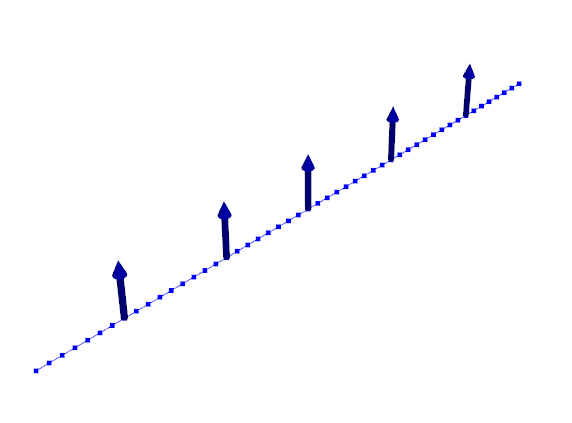

In [99]:
# This will remove the nodes and also the traceline
optimal_geometry = beam_geometry.reduce(optimal_dofs.node)
# Add the traceline back in
optimal_geometry.add_traceline(optimal_dofs.node)
# Plot
optimal_geometry.plot()

(<sdynpy.core.sdynpy_geometry.GeometryPlotter at 0x1490ab3e330>,
 PolyData (0x1490b76cd60)
   N Cells:    1
   N Points:   5
   N Strips:   0
   X Bounds:   1.429e-01, 8.571e-01
   Y Bounds:   0.000e+00, 0.000e+00
   Z Bounds:   0.000e+00, 0.000e+00
   N Arrays:   1,
 PolyData (0x1490b76e980)
   N Cells:    5
   N Points:   5
   N Strips:   0
   X Bounds:   1.429e-01, 8.571e-01
   Y Bounds:   0.000e+00, 0.000e+00
   Z Bounds:   0.000e+00, 0.000e+00
   N Arrays:   2,
 None)

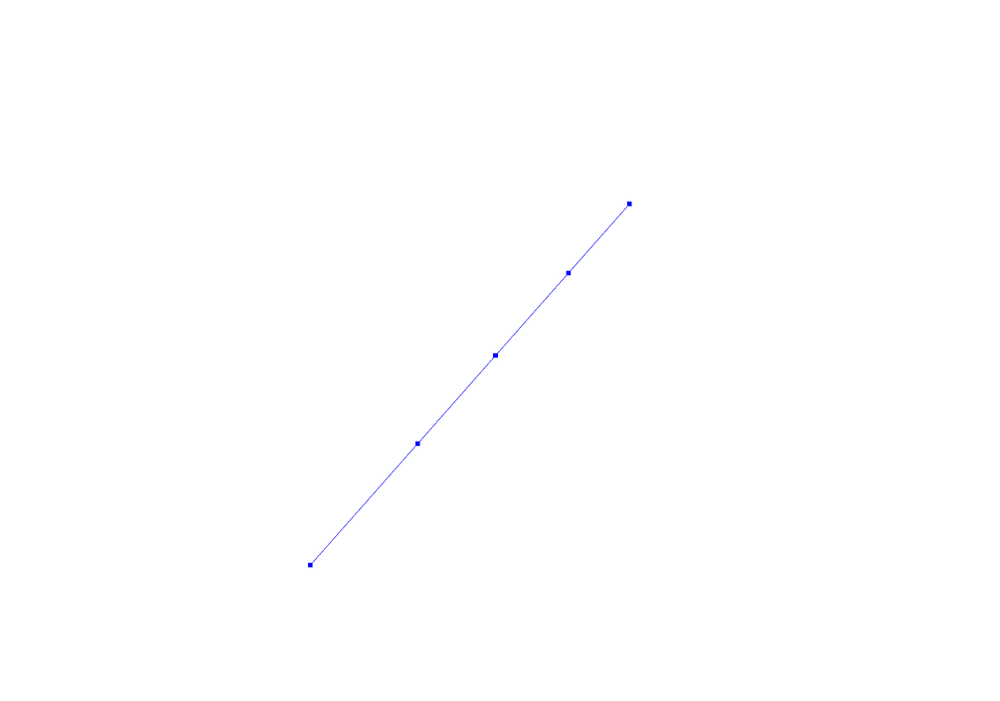


In [103]:
optimal_geometry.plot_shape(optimized_shapes)

| 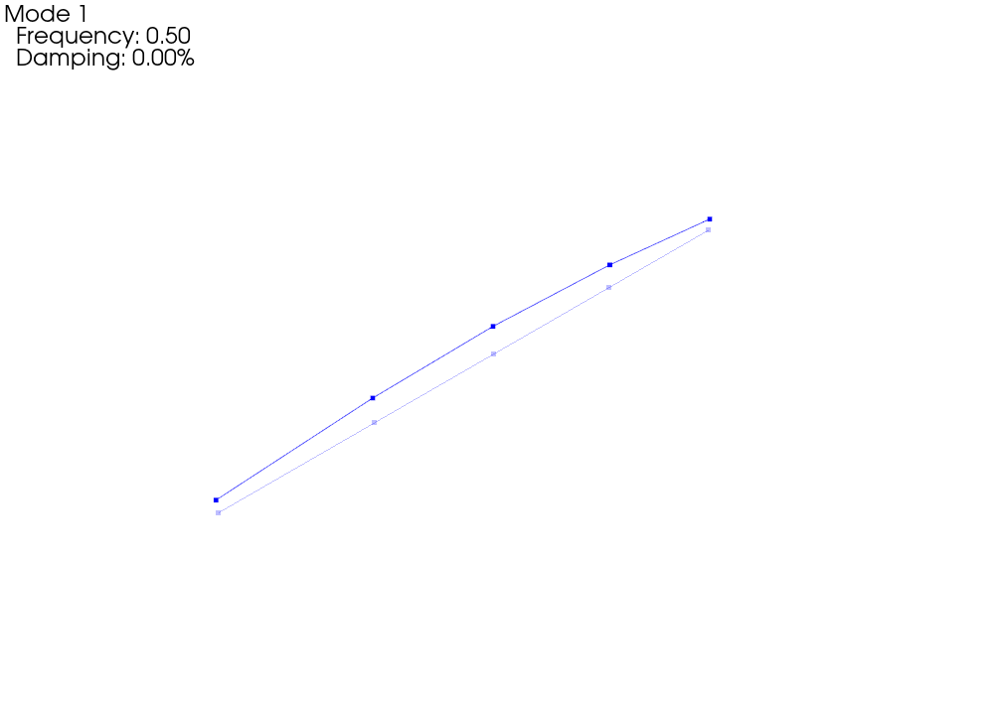 | 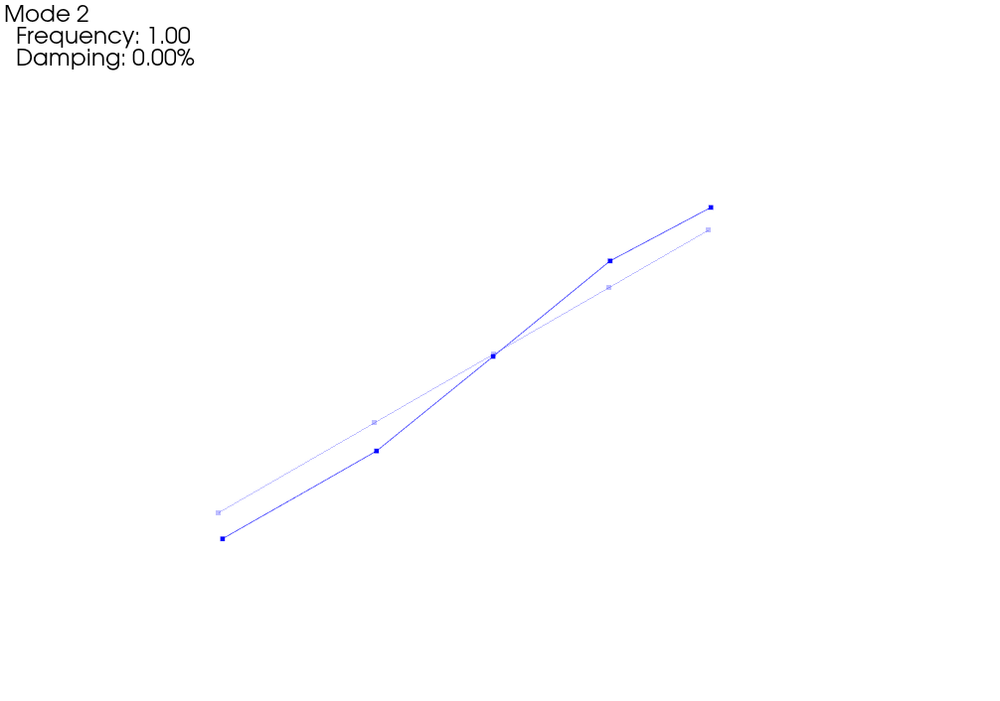 |
|--------------|-----------------|
| 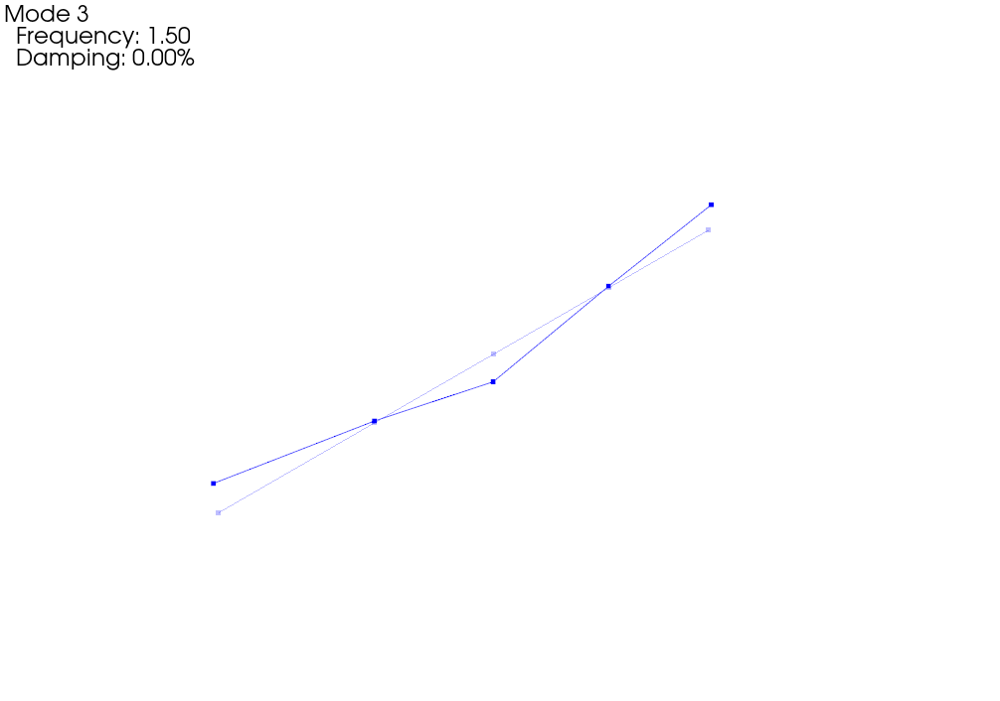 |  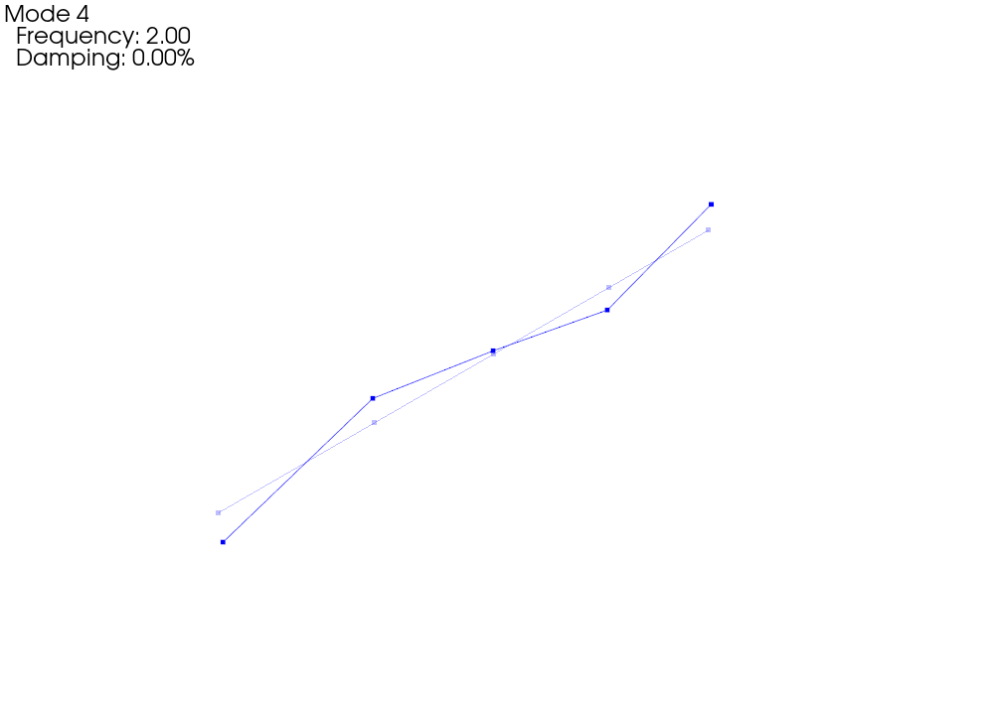 |
| 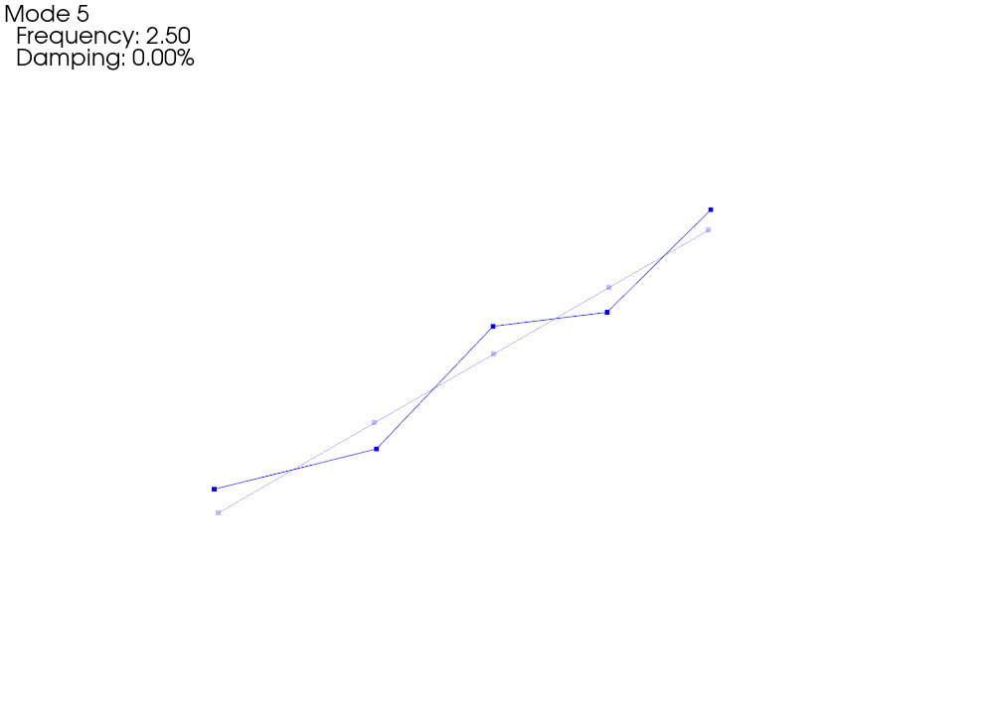 |   |

We can see that the 5 shapes are distinguishable from one another and have relatively large motions at the sensor positions.

## Summary